## Auction Verification Classifiers

The goal of the dataset is to find out whether one could replace costly verification of complex process models (here: simultaneous multi-round auctions, as used for auctioning frequency spectra) with predictions of the outcome.

Features:
- __**process.b1.capacity**__: Capacity (max number of products to win) of Bidder 1.
- __**process.b2.capacity**__: Capacity (max number of products to win) of Bidder 2.
- __**process.b3.capacity**__: Capacity (max number of products to win) of Bidder 3.
- __**process.b4.capacity**__: Capacity (max number of products to win) of Bidder 4.
- __**property.price**__: Price currently verified.
- __**property.product**__: Product currently verified.
- __**property.winner**__: Bidder currently verified as winner of the product (0 if only price verified).
- __**property.winner**__: Bidder currently verified as winner of the product (0 if only price verified).

Targets:
- __**verification.result (Classification)**__: Binary verification result - is the verified outcome possible?
- __**verification.time (Regression)**__: Runtime of verification procedure.	

### Data overview

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


# Load the dataset into a Pandas DataFrame
data = pd.read_csv("./auction_verification.csv", encoding="latin-1")
data.head()

,process.b1.capacity,process.b2.capacity,process.b3.capacity,process.b4.capacity,property.price,property.product,property.winner,verification.result,verification.time
0,0,0,2,1,59,1,0,False,163.316667
1,0,0,2,1,59,2,0,False,200.860000
2,0,0,2,1,59,4,0,False,154.888889
3,0,0,2,1,59,6,0,False,108.640000
4,0,0,2,1,60,1,0,True,85.466667


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2043 entries, 0 to 2042
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   process.b1.capacity  2043 non-null   int64  
 1   process.b2.capacity  2043 non-null   int64  
 2   process.b3.capacity  2043 non-null   int64  
 3   process.b4.capacity  2043 non-null   int64  
 4   property.price       2043 non-null   int64  
 5   property.product     2043 non-null   int64  
 6   property.winner      2043 non-null   int64  
 7   verification.result  2043 non-null   bool   
 8   verification.time    2043 non-null   float64
dtypes: bool(1), float64(1), int64(7)
memory usage: 129.8 KB


The dataset has no missing values

In [4]:
data.describe()

,process.b1.capacity,process.b2.capacity,process.b3.capacity,process.b4.capacity,property.price,property.product,property.winner,verification.time
count,2043.000000,2043.000000,2043.000000,2043.000000,2043.000000,2043.000000,2043.000000,2043.000000
mean,1.000000,2.093979,1.883994,0.587861,71.473324,3.252080,0.455213,7336.944574
std,0.816696,0.811269,0.320310,0.492340,8.048740,1.804225,1.062828,10375.393650
min,0.000000,0.000000,1.000000,0.000000,59.000000,1.000000,0.000000,77.916667
25%,0.000000,1.000000,2.000000,0.000000,65.000000,2.000000,0.000000,546.818910
50%,1.000000,2.000000,2.000000,1.000000,70.000000,3.000000,0.000000,1316.983333
75%,2.000000,3.000000,2.000000,1.000000,78.000000,5.000000,0.000000,10876.638889
max,2.000000,3.000000,2.000000,1.000000,90.000000,6.000000,4.000000,44130.520833


Only __**property.price**__ is a numerical variable. Others are categorical. 

In [5]:
data['property.price'] = data['property.price'].astype('float64')

Since we solve a classification problem I  drop a continuous target variable __**verification.time**__

In [6]:
data.drop(['verification.time'], axis=1, inplace=True)

Diagonsing catagorical variables with histograms

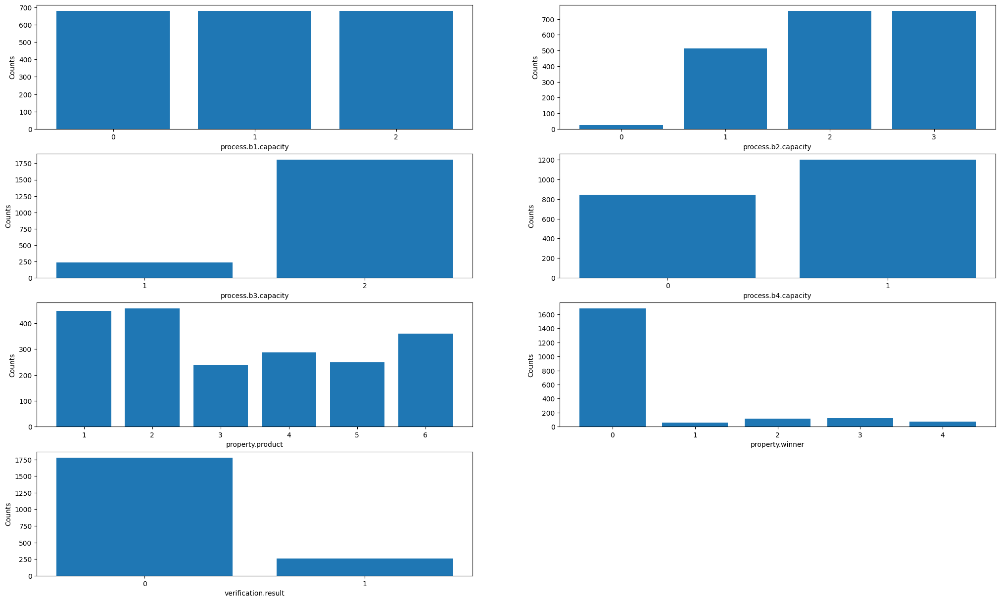

In [7]:
categorical_features = []
fig = plt.figure(figsize=(25, 15))
i = 1
for ft in data.columns:
    if not str(data[ft].dtype).startswith('float'):
        categorical_features.append(ft)
        
        plt.subplot(4, 2, i)
        plt.bar(data[ft].value_counts().index, data[ft].value_counts().values)
        plt.xticks(data[ft].value_counts().index)
        plt.xlabel(f'{ft}')
        plt.ylabel('Counts')
        i += 1
categorical_features.pop(-1)
plt.show()

We have an imbalanced dataset with more 0 target values than 1. That is due to __**property.winner**__ being 0 for most values, i.e. cases when only prices are verified, not the winner.

Text(0.5, 0, 'property.price')

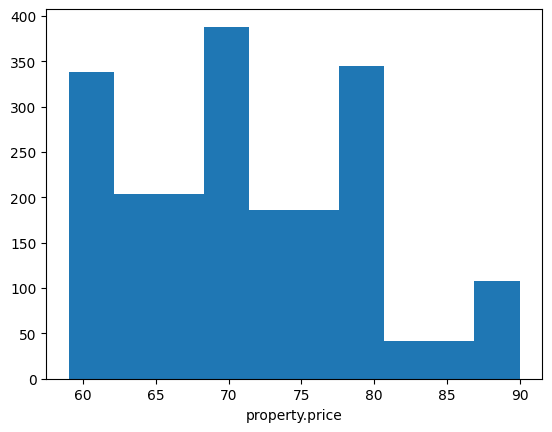

In [8]:
plt.hist(data['property.price'])
plt.xlabel('property.price')

### Feature engineering

Creating dummies for categorical features and standard scaler for the numerical variable.

In [9]:
encoded_data = pd.get_dummies(data, columns=categorical_features).astype('float32')

In [10]:
from sklearn.preprocessing import StandardScaler

encoded_data['property.price'] = StandardScaler().fit_transform(np.array(encoded_data['property.price']).reshape(-1, 1))

In [11]:
encoded_data.head()

,property.price,verification.result,process.b1.capacity_0,process.b1.capacity_1,process.b1.capacity_2,process.b2.capacity_0,process.b2.capacity_1,process.b2.capacity_2,process.b2.capacity_3,process.b3.capacity_1,...,property.product_2,property.product_3,property.product_4,property.product_5,property.product_6,property.winner_0,property.winner_1,property.winner_2,property.winner_3,property.winner_4
0,-1.550103,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,-1.550103,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2,-1.550103,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,-1.550103,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
4,-1.425830,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


Separating features and a target variables

In [12]:
X, y = encoded_data[[col for col in encoded_data.columns if col != 'verification.result']], encoded_data['verification.result']

### Train, test and validation split

In [13]:
from sklearn.model_selection import train_test_split

X_train_all, X_test, y_train_all, y_test = train_test_split(X, y, test_size=.2)

In [14]:
X_train, X_val, y_train, y_val = train_test_split(X_train_all, y_train_all, test_size=.2)

### Random Forest

In [15]:
from sklearn.metrics import roc_auc_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.ensemble import RandomForestClassifier

baseline = RandomForestClassifier()
baseline.fit(X_train, y_train)

RandomForestClassifier()

In [16]:
y_pred = baseline.predict(X_val)
print(f'ROC AUC score: {roc_auc_score(y_val, y_pred)}')

ROC AUC score: 0.868421052631579


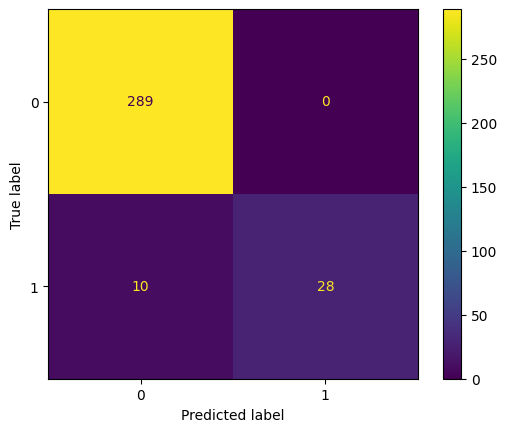

In [17]:
cm = confusion_matrix(y_val, y_pred)
ConfusionMatrixDisplay(cm).plot()

#### Random Forest grid search parameter tuning

In [18]:
from sklearn.model_selection import GridSearchCV

parameters = {
    'n_estimators': [100, 200, 250, 300, 350],
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': [3, 7, 10, 15],
    'bootstrap': [True, False]
}

In [19]:
grid_cv = GridSearchCV(RandomForestClassifier(), parameters, scoring='roc_auc')
results = grid_cv.fit(X_train_all, y_train_all)

In [20]:
results.best_estimator_

RandomForestClassifier(bootstrap=False, criterion='log_loss', max_depth=10)

In [21]:
results.best_score_

0.9966409641866374

In [45]:
random_forest_classifier = RandomForestClassifier(bootstrap=False, criterion='log_loss', max_depth=10,
                       n_estimators=250)

### Boosting

In [23]:
import lightgbm as lgbm

baseline = lgbm.LGBMClassifier()
baseline.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 184, number of negative: 1123
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001634 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 75
[LightGBM] [Info] Number of data points in the train set: 1307, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.140780 -> initscore=-1.808823
[LightGBM] [Info] Start training from score -1.808823
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

LGBMClassifier()

In [24]:
y_pred = baseline.predict(X_val)
print(f'ROC AUC: {roc_auc_score(y_val, y_pred)}')

ROC AUC: 0.9851120014569296


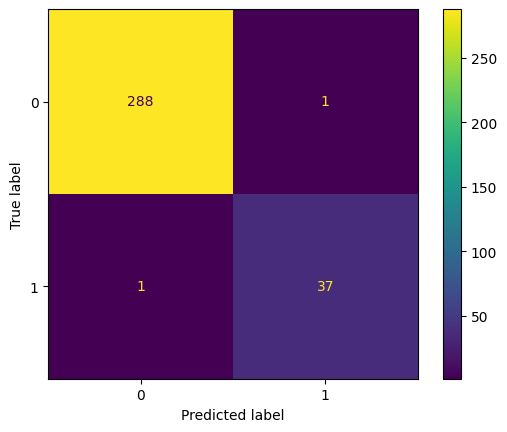

In [25]:
cm = confusion_matrix(y_val, y_pred)
ConfusionMatrixDisplay(cm).plot()

#### Boosting Grid Search Hyperparameter tuning

In [29]:
parameters = {
    'n_estimators': [210, 230, 250, 270, 290],
    'max_depth': [7, 8, 9, 10],
    'boosting_type': ['gbdt', 'dart'],
    'learning_rate': [0.1, 0.01, 0.001],
    'num_leaves': [10, 30, 50, 60]
}

grid_cv = GridSearchCV(lgbm.LGBMClassifier(), parameters, scoring='roc_auc')
results = grid_cv.fit(X_train_all, y_train_all)

[LightGBM] [Info] Number of positive: 178, number of negative: 1129
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 75
[LightGBM] [Info] Number of data points in the train set: 1307, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.136190 -> initscore=-1.847304
[LightGBM] [Info] Start training from score -1.847304
[LightGBM] [Info] Number of positive: 178, number of negative: 1129
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001680 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 75
[LightGBM] [Info] Number of data points in the train set: 1307, number of used features: 22
[LightGBM] [Info] [binar

In [30]:
results.best_params_

{'boosting_type': 'gbdt',
 'learning_rate': 0.1,
 'max_depth': 8,
 'n_estimators': 290,
 'num_leaves': 50}

In [31]:
results.best_score_

0.9994046851493661

In [39]:
lgbm_classifier = lgbm.LGBMClassifier(boosting_type='gbdt', learning_rate=0.1, max_depth=8, n_estimators=290, num_leaves=50)

### Stacking

In [40]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import StackingClassifier

estimators = [
    ('dtc', DecisionTreeClassifier()),
    ('svc', SVC()),
    ('lr', LogisticRegression())
]
baseline = StackingClassifier(estimators, final_estimator=RandomForestClassifier())
baseline.fit(X_train, y_train)

StackingClassifier(estimators=[('dtc', DecisionTreeClassifier()),
                               ('svc', SVC()), ('lr', LogisticRegression())],
                   final_estimator=RandomForestClassifier())

In [41]:
y_pred = baseline.predict(X_val)
print(f'ROC AUC: {roc_auc_score(y_val, y_pred)}')

ROC AUC: 1.0


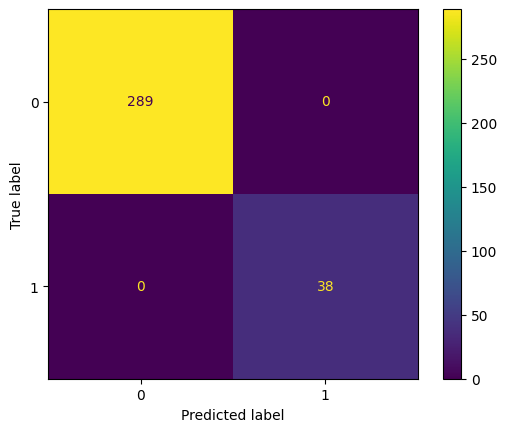

In [42]:
cm = confusion_matrix(y_val, y_pred)
ConfusionMatrixDisplay(cm).plot()

In [43]:
stk_classifier = StackingClassifier(estimators, final_estimator=RandomForestClassifier(n_estimators=250, max_depth=10))

Confusion Matrix shows perfect classification by the stacking

### Model Comparison

In [47]:
random_forest_classifier.fit(X_train_all, y_train_all)
lgbm_classifier.fit(X_train_all, y_train_all)
stk_classifier.fit(X_train_all, y_train_all)

[LightGBM] [Info] Number of positive: 222, number of negative: 1412
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000119 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 75
[LightGBM] [Info] Number of data points in the train set: 1634, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.135863 -> initscore=-1.850085
[LightGBM] [Info] Start training from score -1.850085
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

StackingClassifier(estimators=[('dtc', DecisionTreeClassifier()),
                               ('svc', SVC()), ('lr', LogisticRegression())],
                   final_estimator=RandomForestClassifier(max_depth=10,
                                                          n_estimators=250))

ROC AUC for RandomForestClassifier: 0.8959349593495936
ROC AUC for LGBMClassifier: 0.9959349593495934
ROC AUC for StackingClassifier: 0.9959349593495934


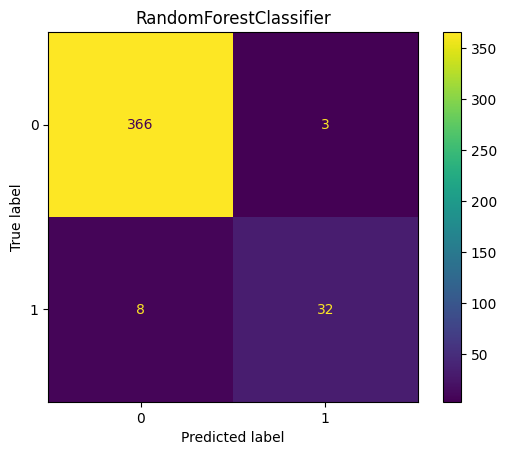

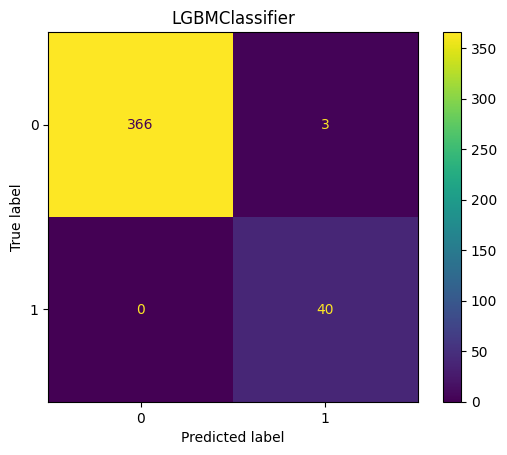

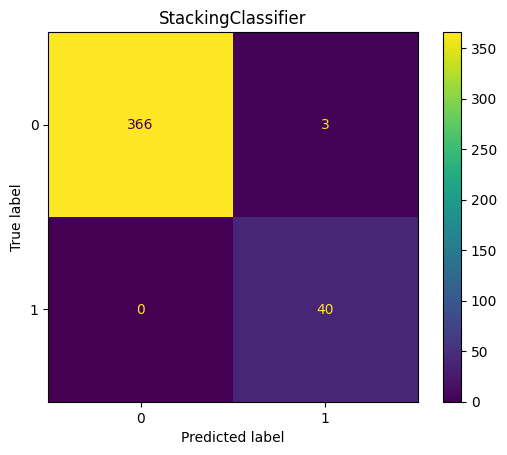

In [48]:
models = [random_forest_classifier, lgbm_classifier, stk_classifier]
for i, model in enumerate(models, start=1):
    y_pred = model.predict(X_test)
    print(f'ROC AUC for {type(model).__name__}: {roc_auc_score(y_test, y_pred)}')
    
    cm = confusion_matrix(y_test, y_pred)
    ConfusionMatrixDisplay(cm).plot()
    plt.title(f'{type(model).__name__}')


The Random Forest classifier is the worst on the teste data based on ROC AUC and classification matrix, but its ROC AUC is still high being over 0.89.
The tuned LGBM classifier and Stacking give the best performance correctly predicting almost all, but 3 classes on the test data. Also, they give the same highe ROC AUC score.